## Imports & Stuff

In [258]:
import pandas as pd
## pandas 1.1.1 necessary
import numpy as np
import string 
import re
from sklearn.feature_extraction.text import TfidfVectorizer
import math
from gensim.models import Word2Vec
from plotly.graph_objects import Scatter3d
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import WhitespaceTokenizer
from nltk.corpus import stopwords 

In [259]:
! pwd

/c/Users/psmag/code/simonjpastor/delphes/notebooks/simonjpastor_notebooks


In [260]:
data = pd.read_pickle('../../delphes/data/extended_tweet_df')
data

,mep_id,name,country,group,nat_group,twitter,content
0,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,@danutahuebner Bardzo dziękuję @danutahuebner👍...
1,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,Komisja @EP_Justice przyjęła 3 arcyważne proje...
2,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,Komisja @EP_Justice przyjęła 3 projekty pilota...
3,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,"W tym dniu, w tym miejscu, w tej godzinie pros..."
4,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,Bóg nie potrzebuje być przez nikogo broniony i...
...,...,...,...,...,...,...,...
137295,96933,Milan ZVER,Slovenia,Group of the European People's Party (Christia...,Slovenska demokratska stranka,MilanZver,Tedenska akcija od četrtka do srede: zbornik B...
137296,96933,Milan ZVER,Slovenia,Group of the European People's Party (Christia...,Slovenska demokratska stranka,MilanZver,Strong #funding for @EU_H2020 &amp; @EUErasmus...
137297,96933,Milan ZVER,Slovenia,Group of the European People's Party (Christia...,Slovenska demokratska stranka,MilanZver,"2020.06.18 00:00, a date to be noted for those..."
137298,96933,Milan ZVER,Slovenia,Group of the European People's Party (Christia...,Slovenska demokratska stranka,MilanZver,"Ko vsi vedo, da je nekaj noro, pa se iz strahu..."


In [261]:
test_data = data[data['country'] == 'Ireland']

## Preprocessing

In [262]:
# Remove the undesirable elements in the entire dataframe
def rmurl_df(df, column_name):
    '''
    This function removes all the URLs, the #hashtag and the @user of a column made of strings.
    Be careful to apply it BEFORE all the other preprocessing steps (if not it wont'
    be recognized as a URL)
    '''
    df = df.copy()
    df[column_name] = df[column_name].str.replace('http\S+|www.\S+|@\S+|#\S+', '', case=False)
    return df

In [263]:
# Lowercase the tweet's column
def lower_df(df, column_name):
    '''
    This function lowercases a column made of strings.
    '''
    df = df.copy()
    df[column_name] = df[column_name].str.lower()
    return df

In [264]:
# Remove the numbers in the tweet's column
def rmnumbers_df(df, column_name):
    '''
    This function removes all the digits of a column made of strings.
    '''
    df = df.copy()
    def remove_numbers(text):
        return ''.join(word for word in text if not word.isdigit())
    df[column_name] = df[column_name].apply(remove_numbers)
    return df

In [265]:
# Remove the undesirable punctuations in the tweet's column
def rmpunct_df(df, column_name):
    '''
    This function removes all the punctuations, all the "rt" and remove multiple spaces
    of a column made of strings.
    '''
    punct = string.punctuation
    df = df.copy()
    def replace_punct(text):
        for punctu in punct:
            text = text.replace(punctu, ' ')
            text = text.replace(' rt ','')
            text = " ".join(text.split())
        return text
    df[column_name] = df[column_name].apply(replace_punct)
    return df

In [266]:
# Remove the stopwords in the tweet's column
def rmstopwords_df(df, column_name):
    '''
    This function removes all the stopwords of a column made of strings.
    '''
    df = df.copy()
    stop_words = stopwords.words('english')
    def remove_stopwords(text):
        for word in stop_words:
            text = text.replace(f' {word} ', ' ')
        return text
    df[column_name] = df[column_name].apply(remove_stopwords)
    return df

In [269]:
# Lemmatize a column in a dataset
def lemmatize_df(df, column_name):
    '''
    This function lemmatize the words of a column made of strings.
    '''
    df = df.copy()
    wnl = WordNetLemmatizer()
    wt = WhitespaceTokenizer()
    def lemmatize_text(text):
        out_text = [wnl.lemmatize(w) for w in wt.tokenize(text)]
        return ' '.join(word[:] for word in out_text)
    df[column_name] = df[column_name].apply(lemmatize_text)
    return df

In [270]:
# Erase all the words that are 1-letter or 2-letters long
def erase_fewletter_df(df, column_name):
    '''
    One or two letters words are deleted from the dataset.
    '''
    df = df.copy()
    def tester(text):
        text = ' '.join( [w for w in text.split() if len(w)>2] )
        return text

    df[column_name] = df[column_name].apply(tester)
    return df


In [271]:
# Remove the undesirable emojis in the entire dataframe
def rmemojis_df(df):
    '''
    This function removes all the emojis of a column made of strings.
    Be careful to translate in latin alphabet before applying this function : 
    it also removes cyrillic alphabet
    '''
    df = df.copy()
    df = df.astype(str).apply(lambda x: x.str.encode('ascii', 'ignore').str.decode('ascii'))
    return df

In [272]:
test = ['the', 'cat', 'is', 'blue']
' '.join(word[:] for word in test)

'the cat is blue'

In [273]:
test_data = rmurl_df(test_data, 'content')
test_data = lower_df(test_data, 'content')
test_data = rmnumbers_df(test_data, 'content')
test_data = rmpunct_df(test_data, 'content')
test_data = rmstopwords_df(test_data, 'content')
test_data = erase_fewletter_df(test_data, 'content')
test_data = rmemojis_df(test_data)
test_data = lemmatize_df(test_data, 'content')

In [275]:
test_data = test_data.reset_index()

In [276]:
test_data["index"][0]

24722

In [277]:
test_data['content']

0       the northern ireland protocol must protected l...
1       member special committee beating cancer look f...
2       this month shining light childrens cancer parl...
3       yesterday told europe need keep speed amp infr...
4       this letter sent taoiseach clear seeking clari...
                              ...                        
2995                       brendan it favourite item desk
2996    monday morning mean tidy desk chaos ahead week...
2997    fergal post kick new week thank folk like maki...
2998    it took rare vision unique leadership see beyo...
2999                                             took min
Name: content, Length: 3000, dtype: object

## Word2Vec 

In [280]:
sentences = list(test_data['content'])

In [281]:
sentences_train = []
for sentence in sentences:
    sentences_train.append(sentence.split())

## TF-IDF

In [282]:
def word2vec_embedding(sentences,size,min_count):
    ### build word embedding for each reviews
    word2vec_model = Word2Vec(sentences, size=size, min_count=min_count)
    return word2vec_model

In [283]:
def weight_of_words(text):
    #takes text and returns a dictionary with the word and its weight
    vectorizer = TfidfVectorizer()
    X = vectorizer.fit(text)
    weight_of_words = dict(zip(X.get_feature_names(),X.idf_))
    return weight_of_words

In [284]:
weight_of_words(sentences)

{'abandoned': 7.620406484320476,
 'abandonment': 8.313553664880422,
 'abela': 8.313553664880422,
 'abhorrence': 8.313553664880422,
 'abiding': 8.313553664880422,
 'ability': 7.3972629330062665,
 'abject': 8.313553664880422,
 'able': 5.828647015092422,
 'ableism': 8.313553664880422,
 'abolish': 8.313553664880422,
 'abomination': 7.908088556772258,
 'about': 7.0607906963850535,
 'abroad': 6.608805572641996,
 'absence': 7.3972629330062665,
 'absent': 8.313553664880422,
 'absolute': 7.2149413762123125,
 'absolutely': 6.298650644338157,
 'abstained': 8.313553664880422,
 'abstention': 8.313553664880422,
 'absurdity': 8.313553664880422,
 'abundance': 8.313553664880422,
 'abuse': 7.2149413762123125,
 'abysmal': 8.313553664880422,
 'academia': 7.908088556772258,
 'academic': 8.313553664880422,
 'academy': 7.908088556772258,
 'acc': 8.313553664880422,
 'accelerate': 7.908088556772258,
 'accelerated': 7.908088556772258,
 'accept': 7.620406484320476,
 'acceptable': 7.3972629330062665,
 'accepted':

In [285]:
def weighted_words(text, weight_of_words, word2vec):
    tweet_vecs = []
    #returns a list of n_tweets dimensions containing a (1,100) vector for each word
    check = 0
    for sentence in text:
        divided_sentence = sentence.split(' ')
        new_vecs = []
        for word in divided_sentence: 
            if word in weight_of_words.keys():
                pondered = word2vec.wv.get_vector(word).reshape(1, 100)
                check += 1
                print(check)
                pondered_word = pondered*weight_of_words[word]
                new_vecs.append(pondered_word)
            else:
                continue
        tweet_vecs.append(new_vecs)
    return tweet_vecs

In [286]:
tryout = weighted_words(sentences, weight_of_words(sentences),word2vec_embedding(sentences=sentences_train, size=100, min_count=1))

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


2162
2163
2164
2165
2166
2167
2168
2169
2170
2171
2172
2173
2174
2175
2176
2177
2178
2179
2180
2181
2182
2183
2184
2185
2186
2187
2188
2189
2190
2191
2192
2193
2194
2195
2196
2197
2198
2199
2200
2201
2202
2203
2204
2205
2206
2207
2208
2209
2210
2211
2212
2213
2214
2215
2216
2217
2218
2219
2220
2221
2222
2223
2224
2225
2226
2227
2228
2229
2230
2231
2232
2233
2234
2235
2236
2237
2238
2239
2240
2241
2242
2243
2244
2245
2246
2247
2248
2249
2250
2251
2252
2253
2254
2255
2256
2257
2258
2259
2260
2261
2262
2263
2264
2265
2266
2267
2268
2269
2270
2271
2272
2273
2274
2275
2276
2277
2278
2279
2280
2281
2282
2283
2284
2285
2286
2287
2288
2289
2290
2291
2292
2293
2294
2295
2296
2297
2298
2299
2300
2301
2302
2303
2304
2305
2306
2307
2308
2309
2310
2311
2312
2313
2314
2315
2316
2317
2318
2319
2320
2321
2322
2323
2324
2325
2326
2327
2328
2329
2330
2331
2332
2333
2334
2335
2336
2337
2338
2339
2340
2341
2342
2343
2344
2345
2346
2347
2348
2349
2350
2351
2352
2353
2354
2355
2356
2357
2358
2359
2360
2361


4581
4582
4583
4584
4585
4586
4587
4588
4589
4590
4591
4592
4593
4594
4595
4596
4597
4598
4599
4600
4601
4602
4603
4604
4605
4606
4607
4608
4609
4610
4611
4612
4613
4614
4615
4616
4617
4618
4619
4620
4621
4622
4623
4624
4625
4626
4627
4628
4629
4630
4631
4632
4633
4634
4635
4636
4637
4638
4639
4640
4641
4642
4643
4644
4645
4646
4647
4648
4649
4650
4651
4652
4653
4654
4655
4656
4657
4658
4659
4660
4661
4662
4663
4664
4665
4666
4667
4668
4669
4670
4671
4672
4673
4674
4675
4676
4677
4678
4679
4680
4681
4682
4683
4684
4685
4686
4687
4688
4689
4690
4691
4692
4693
4694
4695
4696
4697
4698
4699
4700
4701
4702
4703
4704
4705
4706
4707
4708
4709
4710
4711
4712
4713
4714
4715
4716
4717
4718
4719
4720
4721
4722
4723
4724
4725
4726
4727
4728
4729
4730
4731
4732
4733
4734
4735
4736
4737
4738
4739
4740
4741
4742
4743
4744
4745
4746
4747
4748
4749
4750
4751
4752
4753
4754
4755
4756
4757
4758
4759
4760
4761
4762
4763
4764
4765
4766
4767
4768
4769
4770
4771
4772
4773
4774
4775
4776
4777
4778
4779
4780


6661
6662
6663
6664
6665
6666
6667
6668
6669
6670
6671
6672
6673
6674
6675
6676
6677
6678
6679
6680
6681
6682
6683
6684
6685
6686
6687
6688
6689
6690
6691
6692
6693
6694
6695
6696
6697
6698
6699
6700
6701
6702
6703
6704
6705
6706
6707
6708
6709
6710
6711
6712
6713
6714
6715
6716
6717
6718
6719
6720
6721
6722
6723
6724
6725
6726
6727
6728
6729
6730
6731
6732
6733
6734
6735
6736
6737
6738
6739
6740
6741
6742
6743
6744
6745
6746
6747
6748
6749
6750
6751
6752
6753
6754
6755
6756
6757
6758
6759
6760
6761
6762
6763
6764
6765
6766
6767
6768
6769
6770
6771
6772
6773
6774
6775
6776
6777
6778
6779
6780
6781
6782
6783
6784
6785
6786
6787
6788
6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860


9037
9038
9039
9040
9041
9042
9043
9044
9045
9046
9047
9048
9049
9050
9051
9052
9053
9054
9055
9056
9057
9058
9059
9060
9061
9062
9063
9064
9065
9066
9067
9068
9069
9070
9071
9072
9073
9074
9075
9076
9077
9078
9079
9080
9081
9082
9083
9084
9085
9086
9087
9088
9089
9090
9091
9092
9093
9094
9095
9096
9097
9098
9099
9100
9101
9102
9103
9104
9105
9106
9107
9108
9109
9110
9111
9112
9113
9114
9115
9116
9117
9118
9119
9120
9121
9122
9123
9124
9125
9126
9127
9128
9129
9130
9131
9132
9133
9134
9135
9136
9137
9138
9139
9140
9141
9142
9143
9144
9145
9146
9147
9148
9149
9150
9151
9152
9153
9154
9155
9156
9157
9158
9159
9160
9161
9162
9163
9164
9165
9166
9167
9168
9169
9170
9171
9172
9173
9174
9175
9176
9177
9178
9179
9180
9181
9182
9183
9184
9185
9186
9187
9188
9189
9190
9191
9192
9193
9194
9195
9196
9197
9198
9199
9200
9201
9202
9203
9204
9205
9206
9207
9208
9209
9210
9211
9212
9213
9214
9215
9216
9217
9218
9219
9220
9221
9222
9223
9224
9225
9226
9227
9228
9229
9230
9231
9232
9233
9234
9235
9236


11160
11161
11162
11163
11164
11165
11166
11167
11168
11169
11170
11171
11172
11173
11174
11175
11176
11177
11178
11179
11180
11181
11182
11183
11184
11185
11186
11187
11188
11189
11190
11191
11192
11193
11194
11195
11196
11197
11198
11199
11200
11201
11202
11203
11204
11205
11206
11207
11208
11209
11210
11211
11212
11213
11214
11215
11216
11217
11218
11219
11220
11221
11222
11223
11224
11225
11226
11227
11228
11229
11230
11231
11232
11233
11234
11235
11236
11237
11238
11239
11240
11241
11242
11243
11244
11245
11246
11247
11248
11249
11250
11251
11252
11253
11254
11255
11256
11257
11258
11259
11260
11261
11262
11263
11264
11265
11266
11267
11268
11269
11270
11271
11272
11273
11274
11275
11276
11277
11278
11279
11280
11281
11282
11283
11284
11285
11286
11287
11288
11289
11290
11291
11292
11293
11294
11295
11296
11297
11298
11299
11300
11301
11302
11303
11304
11305
11306
11307
11308
11309
11310
11311
11312
11313
11314
11315
11316
11317
11318
11319
11320
11321
11322
11323
11324
11325
1132

13581
13582
13583
13584
13585
13586
13587
13588
13589
13590
13591
13592
13593
13594
13595
13596
13597
13598
13599
13600
13601
13602
13603
13604
13605
13606
13607
13608
13609
13610
13611
13612
13613
13614
13615
13616
13617
13618
13619
13620
13621
13622
13623
13624
13625
13626
13627
13628
13629
13630
13631
13632
13633
13634
13635
13636
13637
13638
13639
13640
13641
13642
13643
13644
13645
13646
13647
13648
13649
13650
13651
13652
13653
13654
13655
13656
13657
13658
13659
13660
13661
13662
13663
13664
13665
13666
13667
13668
13669
13670
13671
13672
13673
13674
13675
13676
13677
13678
13679
13680
13681
13682
13683
13684
13685
13686
13687
13688
13689
13690
13691
13692
13693
13694
13695
13696
13697
13698
13699
13700
13701
13702
13703
13704
13705
13706
13707
13708
13709
13710
13711
13712
13713
13714
13715
13716
13717
13718
13719
13720
13721
13722
13723
13724
13725
13726
13727
13728
13729
13730
13731
13732
13733
13734
13735
13736
13737
13738
13739
13740
13741
13742
13743
13744
13745
13746
1374

15721
15722
15723
15724
15725
15726
15727
15728
15729
15730
15731
15732
15733
15734
15735
15736
15737
15738
15739
15740
15741
15742
15743
15744
15745
15746
15747
15748
15749
15750
15751
15752
15753
15754
15755
15756
15757
15758
15759
15760
15761
15762
15763
15764
15765
15766
15767
15768
15769
15770
15771
15772
15773
15774
15775
15776
15777
15778
15779
15780
15781
15782
15783
15784
15785
15786
15787
15788
15789
15790
15791
15792
15793
15794
15795
15796
15797
15798
15799
15800
15801
15802
15803
15804
15805
15806
15807
15808
15809
15810
15811
15812
15813
15814
15815
15816
15817
15818
15819
15820
15821
15822
15823
15824
15825
15826
15827
15828
15829
15830
15831
15832
15833
15834
15835
15836
15837
15838
15839
15840
15841
15842
15843
15844
15845
15846
15847
15848
15849
15850
15851
15852
15853
15854
15855
15856
15857
15858
15859
15860
15861
15862
15863
15864
15865
15866
15867
15868
15869
15870
15871
15872
15873
15874
15875
15876
15877
15878
15879
15880
15881
15882
15883
15884
15885
15886
1588

18159
18160
18161
18162
18163
18164
18165
18166
18167
18168
18169
18170
18171
18172
18173
18174
18175
18176
18177
18178
18179
18180
18181
18182
18183
18184
18185
18186
18187
18188
18189
18190
18191
18192
18193
18194
18195
18196
18197
18198
18199
18200
18201
18202
18203
18204
18205
18206
18207
18208
18209
18210
18211
18212
18213
18214
18215
18216
18217
18218
18219
18220
18221
18222
18223
18224
18225
18226
18227
18228
18229
18230
18231
18232
18233
18234
18235
18236
18237
18238
18239
18240
18241
18242
18243
18244
18245
18246
18247
18248
18249
18250
18251
18252
18253
18254
18255
18256
18257
18258
18259
18260
18261
18262
18263
18264
18265
18266
18267
18268
18269
18270
18271
18272
18273
18274
18275
18276
18277
18278
18279
18280
18281
18282
18283
18284
18285
18286
18287
18288
18289
18290
18291
18292
18293
18294
18295
18296
18297
18298
18299
18300
18301
18302
18303
18304
18305
18306
18307
18308
18309
18310
18311
18312
18313
18314
18315
18316
18317
18318
18319
18320
18321
18322
18323
18324
1832

20658
20659
20660
20661
20662
20663
20664
20665
20666
20667
20668
20669
20670
20671
20672
20673
20674
20675
20676
20677
20678
20679
20680
20681
20682
20683
20684
20685
20686
20687
20688
20689
20690
20691
20692
20693
20694
20695
20696
20697
20698
20699
20700
20701
20702
20703
20704
20705
20706
20707
20708
20709
20710
20711
20712
20713
20714
20715
20716
20717
20718
20719
20720
20721
20722
20723
20724
20725
20726
20727
20728
20729
20730
20731
20732
20733
20734
20735
20736
20737
20738
20739
20740
20741
20742
20743
20744
20745
20746
20747
20748
20749
20750
20751
20752
20753
20754
20755
20756
20757
20758
20759
20760
20761
20762
20763
20764
20765
20766
20767
20768
20769
20770
20771
20772
20773
20774
20775
20776
20777
20778
20779
20780
20781
20782
20783
20784
20785
20786
20787
20788
20789
20790
20791
20792
20793
20794
20795
20796
20797
20798
20799
20800
20801
20802
20803
20804
20805
20806
20807
20808
20809
20810
20811
20812
20813
20814
20815
20816
20817
20818
20819
20820
20821
20822
20823
2082

23158
23159
23160
23161
23162
23163
23164
23165
23166
23167
23168
23169
23170
23171
23172
23173
23174
23175
23176
23177
23178
23179
23180
23181
23182
23183
23184
23185
23186
23187
23188
23189
23190
23191
23192
23193
23194
23195
23196
23197
23198
23199
23200
23201
23202
23203
23204
23205
23206
23207
23208
23209
23210
23211
23212
23213
23214
23215
23216
23217
23218
23219
23220
23221
23222
23223
23224
23225
23226
23227
23228
23229
23230
23231
23232
23233
23234
23235
23236
23237
23238
23239
23240
23241
23242
23243
23244
23245
23246
23247
23248
23249
23250
23251
23252
23253
23254
23255
23256
23257
23258
23259
23260
23261
23262
23263
23264
23265
23266
23267
23268
23269
23270
23271
23272
23273
23274
23275
23276
23277
23278
23279
23280
23281
23282
23283
23284
23285
23286
23287
23288
23289
23290
23291
23292
23293
23294
23295
23296
23297
23298
23299
23300
23301
23302
23303
23304
23305
23306
23307
23308
23309
23310
23311
23312
23313
23314
23315
23316
23317
23318
23319
23320
23321
23322
23323
2332

25657
25658
25659
25660
25661
25662
25663
25664
25665
25666
25667
25668
25669
25670
25671
25672
25673
25674
25675
25676
25677
25678
25679
25680
25681
25682
25683
25684
25685
25686
25687
25688
25689
25690
25691
25692
25693
25694
25695
25696
25697
25698
25699
25700
25701
25702
25703
25704
25705
25706
25707
25708
25709
25710
25711
25712
25713
25714
25715
25716
25717
25718
25719
25720
25721
25722
25723
25724
25725
25726
25727
25728
25729
25730
25731
25732
25733
25734
25735
25736
25737
25738
25739
25740
25741
25742
25743
25744
25745
25746
25747
25748
25749
25750
25751
25752
25753
25754
25755
25756
25757
25758
25759
25760
25761
25762
25763
25764
25765
25766
25767
25768
25769
25770
25771
25772
25773
25774
25775
25776
25777
25778
25779
25780
25781
25782
25783
25784
25785
25786
25787
25788
25789
25790
25791
25792
25793
25794
25795
25796
25797
25798
25799
25800
25801
25802
25803
25804
25805
25806
25807
25808
25809
25810
25811
25812
25813
25814
25815
25816
25817
25818
25819
25820
25821
25822
2582

28157
28158
28159
28160
28161
28162
28163
28164
28165
28166
28167
28168
28169
28170
28171
28172
28173
28174
28175
28176
28177
28178
28179
28180
28181
28182
28183
28184
28185
28186
28187
28188
28189
28190
28191
28192
28193
28194
28195
28196
28197
28198
28199
28200
28201
28202
28203
28204
28205
28206
28207
28208
28209
28210
28211
28212
28213
28214
28215
28216
28217
28218
28219
28220
28221
28222
28223
28224
28225
28226
28227
28228
28229
28230
28231
28232
28233
28234
28235
28236
28237
28238
28239
28240
28241
28242
28243
28244
28245
28246
28247
28248
28249
28250
28251
28252
28253
28254
28255
28256
28257
28258
28259
28260
28261
28262
28263
28264
28265
28266
28267
28268
28269
28270
28271
28272
28273
28274
28275
28276
28277
28278
28279
28280
28281
28282
28283
28284
28285
28286
28287
28288
28289
28290
28291
28292
28293
28294
28295
28296
28297
28298
28299
28300
28301
28302
28303
28304
28305
28306
28307
28308
28309
28310
28311
28312
28313
28314
28315
28316
28317
28318
28319
28320
28321
28322
2832

30656
30657
30658
30659
30660
30661
30662
30663
30664
30665
30666
30667
30668
30669
30670
30671
30672
30673
30674
30675
30676
30677
30678
30679
30680
30681
30682
30683
30684
30685
30686
30687
30688
30689
30690
30691
30692
30693
30694
30695
30696
30697
30698
30699
30700
30701
30702
30703
30704
30705
30706
30707
30708
30709
30710
30711
30712
30713
30714
30715
30716
30717
30718
30719
30720
30721
30722
30723
30724
30725
30726
30727
30728
30729
30730
30731
30732
30733
30734
30735
30736
30737
30738
30739
30740
30741
30742
30743
30744
30745
30746
30747
30748
30749
30750
30751
30752
30753
30754
30755
30756
30757
30758
30759
30760
30761
30762
30763
30764
30765
30766
30767
30768
30769
30770
30771
30772
30773
30774
30775
30776
30777
30778
30779
30780
30781
30782
30783
30784
30785
30786
30787
30788
30789
30790
30791
30792
30793
30794
30795
30796
30797
30798
30799
30800
30801
30802
30803
30804
30805
30806
30807
30808
30809
30810
30811
30812
30813
30814
30815
30816
30817
30818
30819
30820
30821
3082

33156
33157
33158
33159
33160
33161
33162
33163
33164
33165
33166
33167
33168
33169
33170
33171
33172
33173
33174
33175
33176
33177
33178
33179
33180
33181
33182
33183
33184
33185
33186
33187
33188
33189
33190
33191
33192
33193
33194
33195
33196
33197
33198
33199
33200
33201
33202
33203
33204
33205
33206
33207
33208
33209
33210
33211
33212
33213
33214
33215
33216
33217
33218
33219
33220
33221
33222
33223
33224
33225
33226
33227
33228
33229
33230
33231
33232
33233
33234
33235
33236
33237
33238
33239
33240
33241
33242
33243
33244
33245
33246
33247
33248
33249
33250
33251
33252
33253
33254
33255
33256
33257
33258
33259
33260
33261
33262
33263
33264
33265
33266
33267
33268
33269
33270
33271
33272
33273
33274
33275
33276
33277
33278
33279
33280
33281
33282
33283
33284
33285
33286
33287
33288
33289
33290
33291
33292
33293
33294
33295
33296
33297
33298
33299
33300
33301
33302
33303
33304
33305
33306
33307
33308
33309
33310
33311
33312
33313
33314
33315
33316
33317
33318
33319
33320
33321
3332

35655
35656
35657
35658
35659
35660
35661
35662
35663
35664
35665
35666
35667
35668
35669
35670
35671
35672
35673
35674
35675
35676
35677
35678
35679
35680
35681
35682
35683
35684
35685
35686
35687
35688
35689
35690
35691
35692
35693
35694
35695
35696
35697
35698
35699
35700
35701
35702
35703
35704
35705
35706
35707
35708
35709
35710
35711
35712
35713
35714
35715
35716
35717
35718
35719
35720
35721
35722
35723
35724
35725
35726
35727
35728
35729
35730
35731
35732
35733
35734
35735
35736
35737
35738
35739
35740
35741
35742
35743
35744
35745
35746
35747
35748
35749
35750
35751
35752
35753
35754
35755
35756
35757
35758
35759
35760
35761
35762
35763
35764
35765
35766
35767
35768
35769
35770
35771
35772
35773
35774
35775
35776
35777
35778
35779
35780
35781
35782
35783
35784
35785
35786
35787
35788
35789
35790
35791
35792
35793
35794
35795
35796
35797
35798
35799
35800
35801
35802
35803
35804
35805
35806
35807
35808
35809
35810
35811
35812
35813
35814
35815
35816
35817
35818
35819
35820
3582

38155
38156
38157
38158
38159
38160
38161
38162
38163
38164
38165
38166
38167
38168
38169
38170
38171
38172
38173
38174
38175
38176
38177
38178
38179
38180
38181
38182
38183
38184
38185
38186
38187
38188
38189
38190
38191
38192
38193
38194
38195
38196
38197
38198
38199
38200
38201
38202
38203
38204
38205
38206
38207
38208
38209
38210
38211
38212
38213
38214
38215
38216
38217
38218
38219
38220
38221
38222
38223
38224
38225
38226
38227
38228
38229
38230
38231
38232
38233
38234
38235
38236
38237
38238
38239
38240
38241
38242
38243
38244
38245
38246
38247
38248
38249
38250
38251
38252
38253
38254
38255
38256
38257
38258
38259
38260
38261
38262
38263
38264
38265
38266
38267
38268
38269
38270
38271
38272
38273
38274
38275
38276
38277
38278
38279
38280
38281
38282
38283
38284
38285
38286
38287
38288
38289
38290
38291
38292
38293
38294
38295
38296
38297
38298
38299
38300
38301
38302
38303
38304
38305
38306
38307
38308
38309
38310
38311
38312
38313
38314
38315
38316
38317
38318
38319
38320
3832

40395
40396
40397
40398
40399
40400
40401
40402
40403
40404
40405
40406
40407
40408
40409
40410
40411
40412
40413
40414
40415
40416
40417
40418
40419
40420
40421
40422
40423
40424
40425
40426
40427
40428
40429
40430
40431
40432
40433
40434
40435
40436
40437
40438
40439
40440
40441
40442
40443
40444
40445
40446
40447
40448
40449
40450
40451
40452
40453
40454
40455
40456
40457
40458
40459
40460
40461
40462
40463
40464
40465
40466
40467
40468
40469
40470
40471
40472
40473
40474
40475
40476
40477
40478
40479
40480
40481
40482
40483
40484
40485
40486
40487
40488
40489
40490
40491
40492
40493
40494
40495
40496
40497
40498
40499
40500
40501
40502
40503
40504
40505
40506
40507
40508
40509
40510
40511
40512
40513
40514
40515
40516
40517
40518
40519
40520
40521
40522
40523
40524
40525
40526
40527
40528
40529
40530
40531
40532
40533
40534
40535
40536
40537
40538
40539
40540
40541
40542
40543
40544
40545
40546
40547
40548
40549
40550
40551
40552
40553
40554
40555
40556
40557
40558
40559
40560
4056

42654
42655
42656
42657
42658
42659
42660
42661
42662
42663
42664
42665
42666
42667
42668
42669
42670
42671
42672
42673
42674
42675
42676
42677
42678
42679
42680
42681
42682
42683
42684
42685
42686
42687
42688
42689
42690
42691
42692
42693
42694
42695
42696
42697
42698
42699
42700
42701
42702
42703
42704
42705
42706
42707
42708
42709
42710
42711
42712
42713
42714
42715
42716
42717
42718
42719
42720
42721
42722
42723
42724
42725
42726
42727
42728
42729
42730
42731
42732
42733
42734
42735
42736
42737
42738
42739
42740
42741
42742
42743
42744
42745
42746
42747
42748
42749
42750
42751
42752
42753
42754
42755
42756
42757
42758
42759
42760
42761
42762
42763
42764
42765
42766
42767
42768
42769
42770
42771
42772
42773
42774
42775
42776
42777
42778
42779
42780
42781
42782
42783
42784
42785
42786
42787
42788
42789
42790
42791
42792
42793
42794
42795
42796
42797
42798
42799
42800
42801
42802
42803
42804
42805
42806
42807
42808
42809
42810
42811
42812
42813
42814
42815
42816
42817
42818
42819
4282

In [287]:
tryout

[[array([[-0.9667733 , -0.24446762, -0.5830831 ,  0.13261266,  0.3981338 ,
          -0.13209432,  0.24294172, -0.12838437, -0.08296148, -0.23137537,
          -0.73840463, -0.42245412, -0.34314898,  0.6928314 ,  0.4493696 ,
           0.42525107, -0.12794176, -0.36490986, -0.7150125 ,  0.22312318,
          -0.8554796 ,  0.01333452,  0.49993676,  0.04500464,  0.07712913,
           0.05177478,  0.45979652, -0.14865711,  0.28021285,  0.00180758,
          -0.5418852 ,  0.12705328,  0.08613026, -0.6545203 ,  0.5849015 ,
          -0.18535002, -0.28410748,  0.66988593, -0.00853675, -0.09822337,
          -0.7316299 ,  0.4861002 , -0.25451192, -0.3624197 , -0.2844257 ,
           0.16532394,  0.05495112, -0.03047889, -0.4872791 , -0.3225306 ,
           0.38015753, -0.16711475,  0.14248656, -0.28867602, -0.32920554,
           0.06810667, -0.0270715 , -0.13912207, -0.22518767,  0.5608424 ,
          -0.12924685,  0.5132656 ,  0.3224015 ,  0.17435141, -1.0820366 ,
           0.3201728 , -0

In [288]:
def weight_tweets(tweet_weighted_vecs):
    tweets = []
    #returns a single (1,100) vector per tweet
    for i in range (0,3000):
        result = 0
        if len(tryout[i]) != 0:
            result = sum(tryout[i])/len(tryout[i])
            tweets.append(result.tolist())
        else: 
            tweets.append(0)
    return tweets

In [289]:
tweets = weight_tweets(tryout)

In [290]:
tweets

[[[-0.6983413696289062,
   -0.18223902583122253,
   -0.42321446537971497,
   0.09303387254476547,
   0.2888753116130829,
   -0.10261587798595428,
   0.17427976429462433,
   -0.09446099400520325,
   -0.05689842998981476,
   -0.18156400322914124,
   -0.5199191570281982,
   -0.29634004831314087,
   -0.22838194668293,
   0.49608978629112244,
   0.3252885639667511,
   0.29194217920303345,
   -0.09025353938341141,
   -0.25615352392196655,
   -0.5159713625907898,
   0.16748812794685364,
   -0.6024209856987,
   0.010315620340406895,
   0.3640381395816803,
   0.02916662208735943,
   0.04664699733257294,
   0.04693037271499634,
   0.3187651038169861,
   -0.10976050049066544,
   0.19989436864852905,
   0.008846685290336609,
   -0.39151766896247864,
   0.09079042077064514,
   0.0522223524749279,
   -0.47619369626045227,
   0.42097288370132446,
   -0.1174030601978302,
   -0.21074894070625305,
   0.47110477089881897,
   -0.001104522030800581,
   -0.06341660767793655,
   -0.5191263556480408,
   0.348

In [291]:
def df_making(tweets):
    dict_test = {}
    #returns a DataFrame of n_tweets rows and 100 columns
    count = 0
    for i in range (0,len(tweets)):
        if tweets[i] != 0:
            dict_test[test_data["index"][i]] = tweets[i][0]
    return pd.DataFrame.from_dict(dict_test).transpose()

In [292]:
dict_test = df_making(tweets)

In [293]:
dict_test

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
24722,-0.698341,-0.182239,-0.423214,0.093034,0.288875,-0.102616,0.174280,-0.094461,-0.056898,-0.181564,...,0.002518,0.558131,-0.177083,-0.373125,-0.672267,-0.079702,-0.304818,-0.035028,-0.113627,0.264228
24723,-0.731395,-0.194686,-0.444244,0.092039,0.290614,-0.115010,0.187424,-0.100147,-0.064278,-0.175607,...,0.002311,0.576728,-0.179028,-0.386736,-0.692927,-0.091058,-0.328377,-0.030706,-0.110284,0.270351
24724,-0.397293,-0.109824,-0.243093,0.052547,0.151941,-0.054773,0.103258,-0.057322,-0.028452,-0.103513,...,0.014575,0.314034,-0.097626,-0.210301,-0.387854,-0.056057,-0.180467,-0.021579,-0.067719,0.153135
24725,-0.661408,-0.172001,-0.403224,0.081368,0.280856,-0.097177,0.167274,-0.085261,-0.052351,-0.169955,...,0.003453,0.525470,-0.170528,-0.362267,-0.632692,-0.082454,-0.283321,-0.034223,-0.101134,0.249270
24726,-0.363647,-0.092916,-0.211277,0.043345,0.156038,-0.055388,0.085316,-0.050466,-0.025377,-0.100681,...,-0.005899,0.295616,-0.090172,-0.198184,-0.351242,-0.046169,-0.169528,-0.017002,-0.052711,0.139180
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130490,-0.338923,-0.104330,-0.212892,0.041637,0.159135,-0.026815,0.094871,-0.054335,-0.022098,-0.077070,...,0.001257,0.271923,-0.077551,-0.183405,-0.332269,-0.049812,-0.135769,-0.023889,-0.060953,0.119963
130491,-0.567607,-0.157033,-0.343783,0.071585,0.238488,-0.075691,0.141462,-0.080496,-0.045022,-0.145048,...,0.001278,0.456932,-0.143908,-0.308358,-0.549658,-0.080869,-0.245814,-0.026303,-0.089344,0.218025
130492,-0.692944,-0.188278,-0.420096,0.088859,0.287955,-0.106432,0.167875,-0.095249,-0.057384,-0.180507,...,0.003302,0.549919,-0.181984,-0.373933,-0.667271,-0.079593,-0.305803,-0.034932,-0.107812,0.267739
130493,-0.536169,-0.139969,-0.325269,0.080175,0.226673,-0.073568,0.129933,-0.068508,-0.043829,-0.131086,...,0.000590,0.425853,-0.134835,-0.291745,-0.507050,-0.065243,-0.232144,-0.023385,-0.074289,0.201785


## PCA & T-NSE

In [294]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
import plotly

In [295]:
pca = PCA(n_components=3)
pca_result = pca.fit_transform(dict_test.values)
pca_result.shape

(2963, 3)

In [32]:
tsne = TSNE(n_components=3, verbose=1, perplexity=40, n_iter=10000, learning_rate=350, early_exaggeration=20)
tsne_results = tsne.fit_transform(pca_result)
tsne_results

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 2965 samples in 0.004s...
[t-SNE] Computed neighbors for 2965 samples in 0.059s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2965
[t-SNE] Computed conditional probabilities for sample 2000 / 2965
[t-SNE] Computed conditional probabilities for sample 2965 / 2965
[t-SNE] Mean sigma: 0.031515
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.569656
[t-SNE] KL divergence after 6200 iterations: 0.111030


array([[  7.1437654,  11.5377245, -11.9091835],
       [-12.913216 , -18.794228 ,   2.6840425],
       [ 12.16242  ,   0.6912059,  13.093364 ],
       ...,
       [-24.048466 , -11.672347 ,   2.0423217],
       [  9.059178 , -14.025911 ,  12.917764 ],
       [-10.162454 ,   1.9446154,  26.643536 ]], dtype=float32)

In [33]:
#pca_result = pd.DataFrame(pca_result)

In [296]:
pca_result

array([[ 7.01395033e-01,  2.82113861e-03, -5.19293701e-03],
       [ 8.07916048e-01,  4.22231443e-03, -3.30272156e-04],
       [-5.57167012e-01,  3.21310036e-04, -7.91715232e-07],
       ...,
       [ 6.94192752e-01,  5.86378103e-03,  1.01116094e-03],
       [ 1.42834055e-02, -5.86767348e-04,  5.67282091e-03],
       [-1.54283805e+00,  1.25148221e-02,  1.67126476e-02]])

In [297]:
pca.explained_variance_ratio_

array([9.93352446e-01, 1.56651983e-04, 1.42309839e-04])

In [298]:
dict_test

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
24722,-0.698341,-0.182239,-0.423214,0.093034,0.288875,-0.102616,0.174280,-0.094461,-0.056898,-0.181564,...,0.002518,0.558131,-0.177083,-0.373125,-0.672267,-0.079702,-0.304818,-0.035028,-0.113627,0.264228
24723,-0.731395,-0.194686,-0.444244,0.092039,0.290614,-0.115010,0.187424,-0.100147,-0.064278,-0.175607,...,0.002311,0.576728,-0.179028,-0.386736,-0.692927,-0.091058,-0.328377,-0.030706,-0.110284,0.270351
24724,-0.397293,-0.109824,-0.243093,0.052547,0.151941,-0.054773,0.103258,-0.057322,-0.028452,-0.103513,...,0.014575,0.314034,-0.097626,-0.210301,-0.387854,-0.056057,-0.180467,-0.021579,-0.067719,0.153135
24725,-0.661408,-0.172001,-0.403224,0.081368,0.280856,-0.097177,0.167274,-0.085261,-0.052351,-0.169955,...,0.003453,0.525470,-0.170528,-0.362267,-0.632692,-0.082454,-0.283321,-0.034223,-0.101134,0.249270
24726,-0.363647,-0.092916,-0.211277,0.043345,0.156038,-0.055388,0.085316,-0.050466,-0.025377,-0.100681,...,-0.005899,0.295616,-0.090172,-0.198184,-0.351242,-0.046169,-0.169528,-0.017002,-0.052711,0.139180
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130490,-0.338923,-0.104330,-0.212892,0.041637,0.159135,-0.026815,0.094871,-0.054335,-0.022098,-0.077070,...,0.001257,0.271923,-0.077551,-0.183405,-0.332269,-0.049812,-0.135769,-0.023889,-0.060953,0.119963
130491,-0.567607,-0.157033,-0.343783,0.071585,0.238488,-0.075691,0.141462,-0.080496,-0.045022,-0.145048,...,0.001278,0.456932,-0.143908,-0.308358,-0.549658,-0.080869,-0.245814,-0.026303,-0.089344,0.218025
130492,-0.692944,-0.188278,-0.420096,0.088859,0.287955,-0.106432,0.167875,-0.095249,-0.057384,-0.180507,...,0.003302,0.549919,-0.181984,-0.373933,-0.667271,-0.079593,-0.305803,-0.034932,-0.107812,0.267739
130493,-0.536169,-0.139969,-0.325269,0.080175,0.226673,-0.073568,0.129933,-0.068508,-0.043829,-0.131086,...,0.000590,0.425853,-0.134835,-0.291745,-0.507050,-0.065243,-0.232144,-0.023385,-0.074289,0.201785


In [299]:
dict_test = dict_test.reset_index()

In [300]:
new_data = test_data.merge(dict_test, on="index")

In [301]:
! pwd

/c/Users/psmag/code/simonjpastor/delphes/notebooks/simonjpastor_notebooks


In [302]:
new_data.to_csv("visu.tsv",sep='\t')

In [303]:
pca_result

array([[ 7.01395033e-01,  2.82113861e-03, -5.19293701e-03],
       [ 8.07916048e-01,  4.22231443e-03, -3.30272156e-04],
       [-5.57167012e-01,  3.21310036e-04, -7.91715232e-07],
       ...,
       [ 6.94192752e-01,  5.86378103e-03,  1.01116094e-03],
       [ 1.42834055e-02, -5.86767348e-04,  5.67282091e-03],
       [-1.54283805e+00,  1.25148221e-02,  1.67126476e-02]])

In [304]:
x_coord = []
y_coord = []
z_coord = []
for i in pca_result:
    x_coord.append(i[0])
    y_coord.append(i[1])
    z_coord.append(i[2])
new_data["x"] = x_coord
new_data["y"] = y_coord
new_data["z"] = z_coord

In [43]:
tsne_results

array([[  7.1437654,  11.5377245, -11.9091835],
       [-12.913216 , -18.794228 ,   2.6840425],
       [ 12.16242  ,   0.6912059,  13.093364 ],
       ...,
       [-24.048466 , -11.672347 ,   2.0423217],
       [  9.059178 , -14.025911 ,  12.917764 ],
       [-10.162454 ,   1.9446154,  26.643536 ]], dtype=float32)

In [305]:
def color(values):
    if values == 'Fine Gael Party':
        return 0
    elif values == "Green Party":
        return 1
    elif values == "Independent":
        return 2
    elif values == "Sinn Fin":
        return 3
    elif values == "Independents for change":
        return 4
    else:
        return 5

In [306]:
def names(values):
    if values == 'Deirdre CLUNE':
        return 0
    elif values == "Ciarn CUFFE":
        return 1
    elif values == "Frances FITZGERALD":
        return 2
    elif values == "Luke Ming FLANAGAN":
        return 3
    elif values == "Sen KELLY":
        return 4
    elif values == "Mairead McGUINNESS":
        return 5
    elif values == "Chris MACMANUS":
        return 6
    elif values == "Grace O'SULLIVAN":
        return 7
    elif values == "Mick WALLACE":
        return 8
    else:
        return 9

In [307]:
new_data["name"] = new_data["name"].apply(names)

In [308]:
new_data["name"].unique()

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int64)

## Plotting

In [309]:
fig = px.scatter_3d(new_data, x="x", y="y",z="z",color="name")
fig.show()

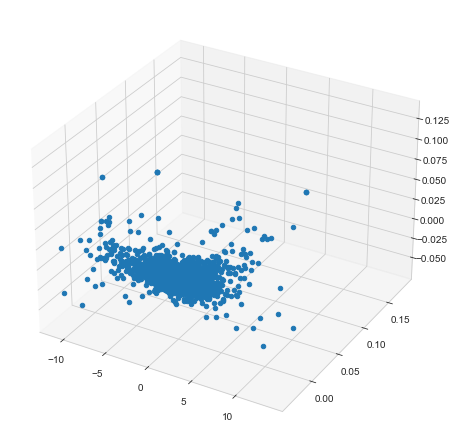

In [48]:
sns.set_style("whitegrid", {'axes.grid' : False})

fig = plt.figure(figsize=(6,6))

ax = Axes3D(fig)

x = x_coord
y = y_coord
z = z_coord


g = ax.scatter(x, y, z, marker='o', depthshade=False, cmap='Paired')

plt.show()

## Color